In [ ]:
!pip install noisereduce
!pip install soundfile

In [2]:
import IPython
from scipy.io import wavfile
import noisereduce as nr
import soundfile as sf
from noisereduce.generate_noise import band_limited_noise
import matplotlib.pyplot as plt
import urllib.request
import numpy as np
import io
%matplotlib inline

In [3]:
#Load Data

In [8]:
data, rate = sf.read("./audio_samples/fish.wav")
data = data

In [9]:
IPython.display.Audio(data=data, rate=rate)

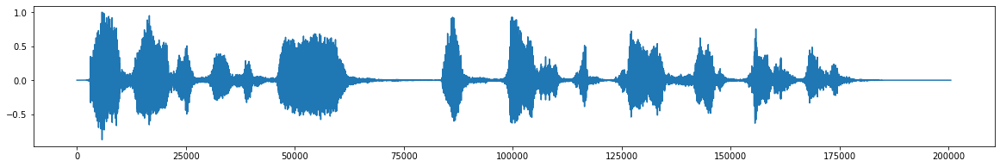

In [10]:
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(data)

In [11]:
#Add Noise

In [12]:
noise_len = 2 # seconds
noise = band_limited_noise(min_freq=2000, max_freq = 12000, samples=len(data), samplerate=rate)*10
noise_clip = noise[:rate*noise_len]
audio_clip_band_limited = data+noise

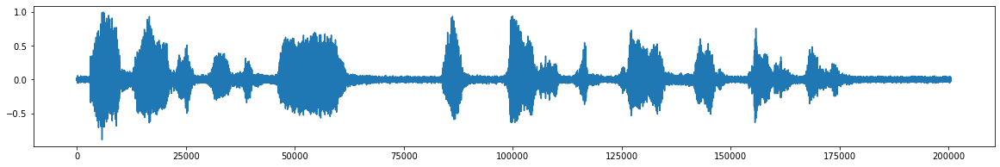

In [13]:
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(audio_clip_band_limited)

In [14]:
IPython.display.Audio(data=audio_clip_band_limited, rate=rate)


In [15]:
#Stationary Noise removal

In [16]:
reduced_noise = nr.reduce_noise(y = audio_clip_band_limited, sr=rate, n_std_thresh_stationary=1.5,stationary=True)

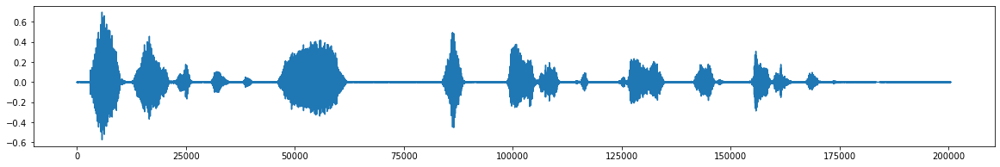

In [17]:
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(reduced_noise)

In [18]:
IPython.display.Audio(data=reduced_noise, rate=rate)


In [19]:
#Non Stationary Noise Reduction

In [20]:

reduced_noise = nr.reduce_noise(y = audio_clip_band_limited, sr=rate, thresh_n_mult_nonstationary=2,stationary=False)

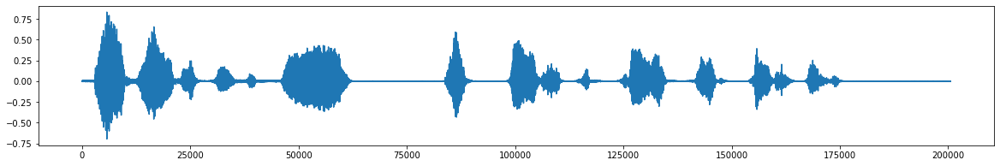

In [21]:
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(reduced_noise)

In [22]:
#Another Example : Talk in cafe

In [23]:
noise_data, noise_rate = sf.read('./audio_samples/cafe_short.wav')

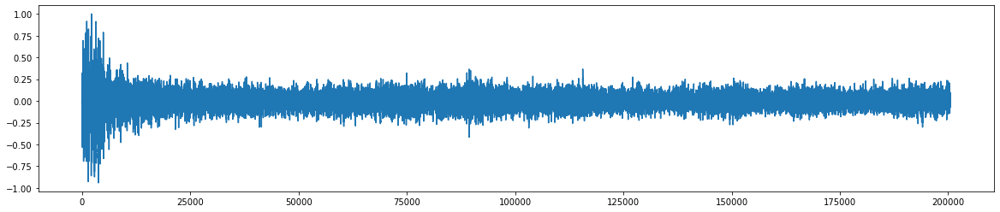

In [24]:
fig, ax = plt.subplots(figsize=(20,4))
ax.plot(noise_data)

In [25]:
IPython.display.Audio(data=noise_data, rate=noise_rate)


In [26]:
# Add noise to data

In [27]:
snr = 2 # signal to noise ratio
noise_clip = noise_data/snr
audio_clip_cafe = data + noise_clip

In [28]:
#plot the noisy data

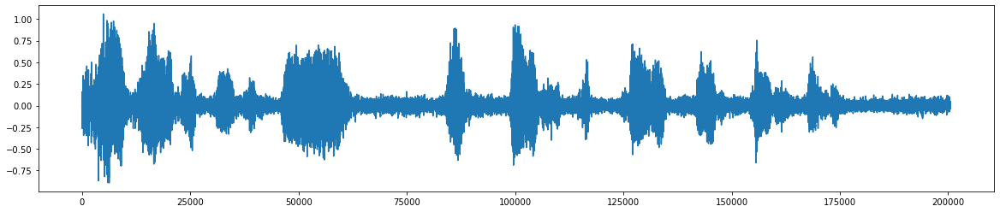

In [29]:
fig, ax = plt.subplots(figsize=(20,4))
ax.plot(audio_clip_cafe)
IPython.display.Audio(data=audio_clip_cafe, rate=noise_rate)

In [30]:
#Stationary Noise Removal

In [31]:
reduced_noise = nr.reduce_noise(y = audio_clip_cafe, sr=rate, y_noise = noise_clip, n_std_thresh_stationary=1.5,stationary=True)

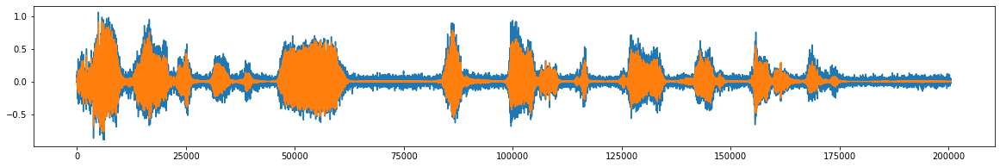

In [32]:
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(audio_clip_cafe)
ax.plot(reduced_noise)

In [33]:
IPython.display.Audio(data=reduced_noise, rate=rate)

In [34]:
#Non-stationary noise reduction

In [36]:
reduced_noise = nr.reduce_noise(y = audio_clip_cafe, sr=rate, thresh_n_mult_nonstationary=2,stationary=False)

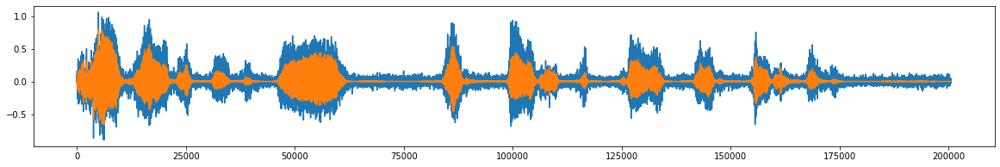

In [37]:
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(audio_clip_cafe)
ax.plot(reduced_noise, alpha = 1)
IPython.display.Audio(data=reduced_noise, rate=rate)

In [38]:
IPython.display.Audio(data=reduced_noise, rate=rate)

In [ ]:
#ensure that noise reduction does not cause distortion when prop_decrease == 0

In [39]:
noise_reduced = nr.reduce_noise(y=data, sr=rate, prop_decrease=0, stationary=False)

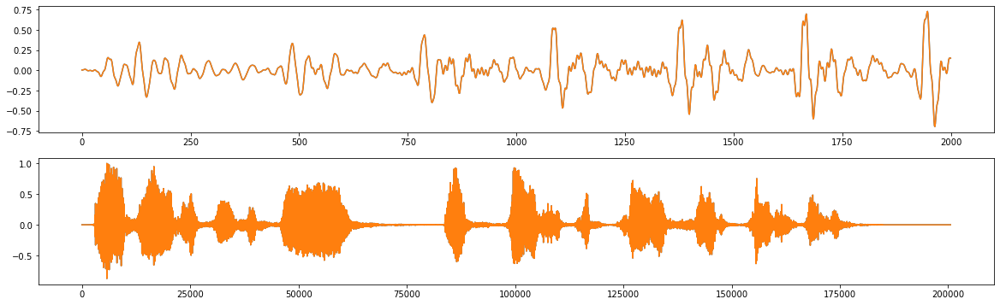

In [41]:
fig, axs = plt.subplots(nrows=2, figsize=(20,6))
axs[0].plot(data[3000:5000])
axs[0].plot(noise_reduced[3000:5000])
axs[1].plot(data)
axs[1].plot(noise_reduced)

In [42]:

noise_reduced = nr.reduce_noise(y=data, sr=rate, prop_decrease=0, stationary=False)

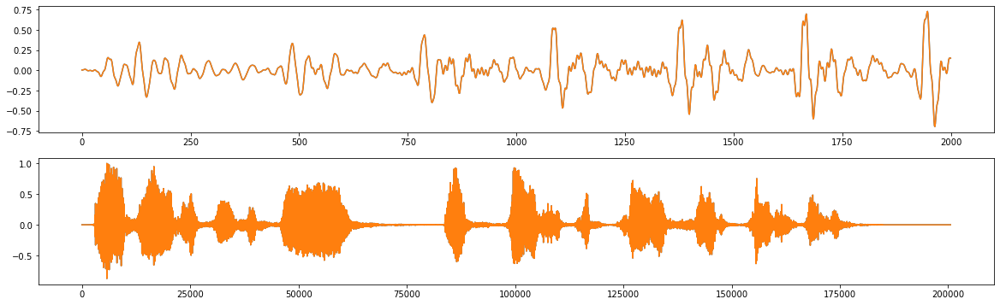

In [43]:
fig, axs = plt.subplots(nrows=2, figsize=(20,6))
axs[0].plot(data[3000:5000])
axs[0].plot(noise_reduced[3000:5000])
axs[1].plot(data)
axs[1].plot(noise_reduced)

In [44]:
#Reduce noise over batches in parallel on long signal

In [45]:
long_data = np.tile(data, 10)
len(long_data)/rate

45.47437641723356

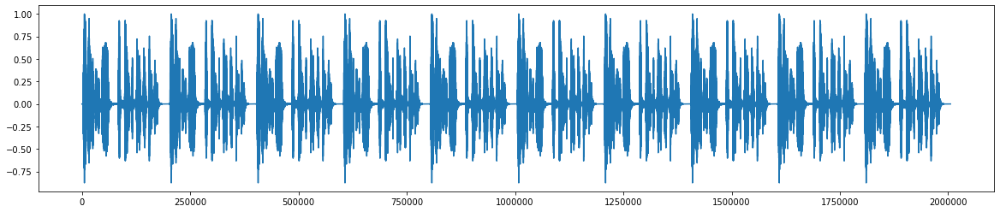

In [46]:
fig, ax = plt.subplots(figsize=(20,4))
ax.plot(long_data)

In [47]:
noise = band_limited_noise(min_freq=2000, max_freq = 12000, samples=len(long_data), samplerate=rate)*10
audio_clip_band_limited = long_data+noise

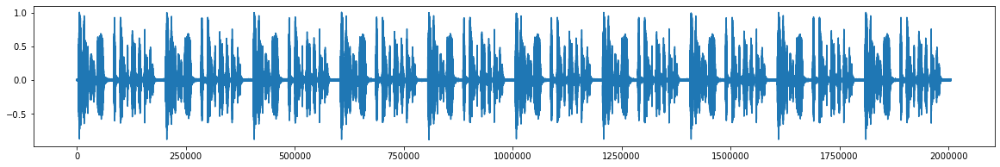

In [48]:
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(audio_clip_band_limited)

In [58]:
reduced_noise = nr.reduce_noise(
    y=audio_clip_band_limited,
    sr=rate,
    thresh_n_mult_nonstationary=2,
    stationary=True,
    )

100%|██████████| 4/4 [00:01<00:00,  3.69it/s]


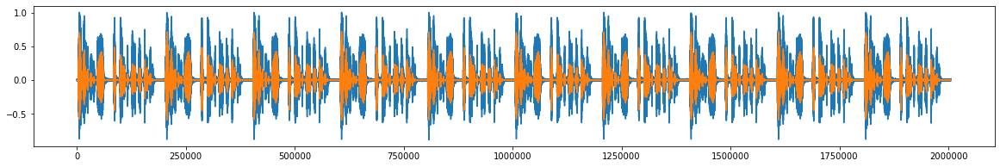

In [59]:
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(audio_clip_band_limited)
ax.plot(reduced_noise)

In [60]:
#Reduce noise on only a subset of a long clip

In [61]:
from noisereduce.noisereduce import SpectralGateStationary

In [62]:
sg = SpectralGateStationary(
    y = data,
    sr = rate,
    y_noise=None,
    prop_decrease=1.0,
    time_constant_s=2.0,
    freq_mask_smooth_hz=500,
    time_mask_smooth_ms=50,
    n_std_thresh_stationary=1.5,
    tmp_folder=None,
    chunk_size=600000,
    padding=30000,
    n_fft=1024,
    win_length=None,
    hop_length=None,
    clip_noise_stationary=True,
    use_tqdm=False,
    n_jobs=1,
)

In [63]:
subset_noise_reduce = sg.get_traces(start_frame = 10000, end_frame = 20000)

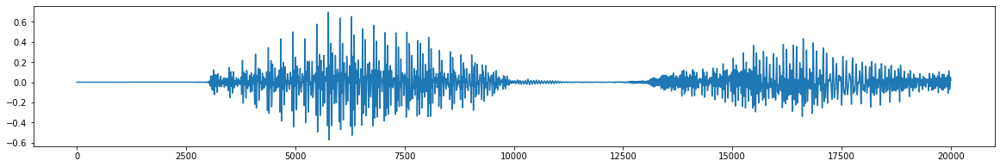

In [64]:
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(subset_noise_reduce)

In [65]:
#Multichannel noise

In [66]:
audio_clip_cafe_2_channel = np.vstack([audio_clip_cafe, audio_clip_cafe])
audio_clip_cafe_2_channel.shape

(2, 200542)

In [67]:
reduced_noise = nr.reduce_noise(y = audio_clip_cafe_2_channel, sr=rate, n_std_thresh_stationary=1.5,stationary=True)

In [68]:
reduced_noise.shape

(2, 200542)

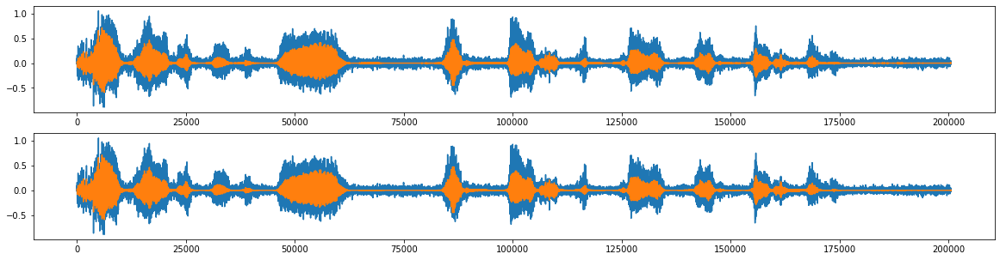

In [69]:
fig, axs = plt.subplots(nrows= 2, figsize=(20,5))
axs[0].plot(audio_clip_cafe_2_channel[0])
axs[1].plot(audio_clip_cafe_2_channel[1])

axs[0].plot(reduced_noise[0])
axs[1].plot(reduced_noise[1])

In [70]:
IPython.display.Audio(data=reduced_noise, rate=rate)

In [71]:
reduced_noise = nr.reduce_noise(y = audio_clip_cafe, sr=rate, thresh_n_mult_nonstationary=2,stationary=False)

In [72]:
reduced_noise.shape

(200542,)

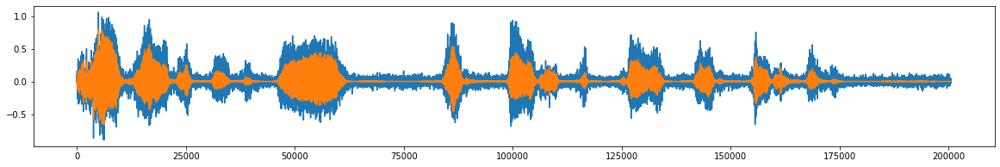

In [73]:
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(audio_clip_cafe)
ax.plot(reduced_noise, alpha = 1)
IPython.display.Audio(data=reduced_noise, rate=rate)